# does this work?

In [ ]:
import sympy as sp
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML  # For displaying animations inline
from scipy.interpolate import interp1d

# **AE370 Group Project 1: Double Pendulum**
## Aditya Srikanth and Nia Smith

## **Introduction: Why the Double Pendulum Is Relevant in Engineering**

The **double pendulum** is a classic example of a nonlinear, coupled dynamic system that highlights the strength of **Lagrangian mechanics**. While traditional Newtonian analysis requires tracking forces and constraints on each mass individually, Lagrangian mechanics allows us to describe the entire system using **generalized coordinates** — in this case, the angular displacements $ \theta_1 $ and $ \theta_2 $.

### The Lagrangian Approach

The **Lagrangian** of a system is defined as:

$$
L = T - V
$$

where $ T $ is the total kinetic energy and $ V $ is the total potential energy. From this, the equations of motion are derived using the **Euler-Lagrange equations**:

$$
\frac{d}{dt} \left( \frac{\partial L}{\partial \dot{q}_i} \right) - \frac{\partial L}{\partial q_i} = 0
$$

This approach leads to a **system of differential equations** that fully characterizes the motion of the pendulum, even in the presence of nonlinear and coupled dynamics.

### Engineering Relevance

The double pendulum exemplifies many challenges that are common in engineering systems:

- **Nonlinearity**: The equations of motion are nonlinear, which is typical in real-world systems.
- **Coupling**: The motion of one link directly affects the other, just like in robotic arms or mechanical linkages.
- **Chaos**: The system is highly sensitive to initial conditions, making it a useful model in control and stability analysis.

Understanding the dynamics of the double pendulum helps engineers develop intuition and analytical techniques that scale to more complex systems such as:

- Robotic manipulators  
- Aerospace attitude dynamics  
- Suspension systems and structural dynamics

Studying the double pendulum using Lagrangian mechanics not only deepens understanding of physical behavior but also introduces engineers to **energy-based modeling**, **symbolic computation**, and **simulation**, all of which are foundational in modern engineering practice.


In [2]:
# Define symbols and Lagrangian (same as your original code)
t = sp.Symbol('t')
theta1 = sp.Function('theta1')(t)
theta2 = sp.Function('theta2')(t)
theta3 = sp.Function('theta3')(t)
dtheta1 = sp.diff(theta1, t)
dtheta2 = sp.diff(theta2, t)
dtheta3 = sp.diff(theta3, t)

m1, m2, m3, l1, l2, l3, g = sp.symbols('m1 m2 m3 l1 l2 l3 g')

# Positions, velocities, energies, and Lagrangian
x1 = l1 * sp.sin(theta1)
y1 = -l1 * sp.cos(theta1)
x2 = x1 + l2 * sp.sin(theta2)
y2 = y1 - l2 * sp.cos(theta2)
x3 = x2 + l3 * sp.sin(theta3)
y3 = y2 - l3 * sp.cos(theta3)

vx1 = sp.diff(x1, t)
vy1 = sp.diff(y1, t)
vx2 = sp.diff(x2, t)
vy2 = sp.diff(y2, t)
vx3 = sp.diff(x3, t)
vy3 = sp.diff(y3, t)

T1 = (1/2) * m1 * (vx1**2 + vy1**2)
T2 = (1/2) * m2 * (vx2**2 + vy2**2)
T3 = (1/2) * m3 * (vx3**2 + vy3**2)

V1 = m1 * g * y1
V2 = m2 * g * y2
V3 = m3 * g * y3

L = T1 + T2 + T3 - V1 - V2 - V3

# Euler-Lagrange equations
def lagrange_eq(L, q):
    dL_dq = sp.diff(L, q)
    dL_ddq = sp.diff(L, sp.diff(q, t))
    dt_dL_ddq = sp.diff(dL_ddq, t)
    return sp.simplify(dt_dL_ddq - dL_dq)

eom1 = lagrange_eq(L, theta1)
eom2 = lagrange_eq(L, theta2)
eom3 = lagrange_eq(L, theta3)

In [3]:
# Solve for theta1'' and theta2''
solutions = sp.solve(
    [sp.Eq(eom1, 0), sp.Eq(eom2, 0), sp.Eq(eom3, 0)],
    [sp.diff(theta1, t, 2), sp.diff(theta2, t, 2), sp.diff(theta3, t, 2)]
)
theta1_ddot = solutions[sp.diff(theta1, t, 2)]
theta2_ddot = solutions[sp.diff(theta2, t, 2)]
theta3_ddot = solutions[sp.diff(theta3, t, 2)]

In [8]:
# Lambdify the expressions for numerical evaluation
theta1_ddot_func = sp.lambdify(
    (theta1, theta2, theta3, dtheta1, dtheta2, dtheta3, g, l1, l2, l3, m1, m2, m3),
    theta1_ddot,
    modules='numpy'
)
theta2_ddot_func = sp.lambdify(
    (theta1, theta2, theta3, dtheta1, dtheta2, dtheta3, g, l1, l2, l3, m1, m2, m3),
    theta2_ddot,
    modules='numpy'
)

theta3_ddot_func = sp.lambdify(
    (theta1, theta2, theta3, dtheta1, dtheta2, dtheta3, g, l1, l2, l3, m1, m2, m3),
    theta3_ddot,
    modules='numpy'
)

# ODE function for scipy.integrate.odeint
def triple_pendulum_ivp(t, y, g, l1, l2, l3, m1, m2, m3):
    # Unpack the state vector y
    theta1, theta2, theta3, omega1, omega2, omega3 = y
    
    # Compute the angular accelerations using the lambdified functions
    theta1_ddot = theta1_ddot_func(theta1, theta2, theta3, omega1, omega2, omega3, g, l1, l2, l3, m1, m2, m3)
    theta2_ddot = theta2_ddot_func(theta1, theta2, theta3, omega1, omega2, omega3, g, l1, l2, l3, m1, m2, m3)
    theta3_ddot = theta3_ddot_func(theta1, theta2, theta3, omega1, omega2, omega3, g, l1, l2, l3, m1, m2, m3)
    
    # Return the derivatives of the state variables (dy/dt)
    return [omega1, omega2, omega3, theta1_ddot, theta2_ddot, theta3_ddot]



In [9]:
def rk4_step(func, t, y, dt, *args):
    k1 = np.array(func(t, y, *args))
    k2 = np.array(func(t + dt/2, y + dt*k1/2, *args))
    k3 = np.array(func(t + dt/2, y + dt*k2/2, *args))
    k4 = np.array(func(t + dt, y + dt*k3, *args))
    
    return y + (dt / 6) * (k1 + 2*k2 + 2*k3 + k4)


def simulate_triple_pendulum_rk4(y0, t_span, dt, params):
    t0, tf = t_span
    times = np.arange(t0, tf, dt)
    states = np.zeros((len(times), len(y0)))
    y = np.array(y0)
    
    for i, t in enumerate(times):
        states[i] = y
        y = rk4_step(triple_pendulum_ivp, t, y, dt, *params)
    
    return times, states

def simulate_triple_pendulum_ab2(y0, t_span, dt, params):
    t0, tf = t_span
    times = np.arange(t0, tf, dt)
    n_steps = len(times)
    y_dim = len(y0)

    # Store solutions
    ys = np.zeros((n_steps, y_dim))
    ys[0] = y0

    # Use RK4 for the first step
    f = triple_pendulum_ivp
    y1 = rk4_step(f, times[0], y0, dt, *params)
    ys[1] = y1

    # Precompute f_n and f_{n-1}
    f_prev = np.array(f(times[0], y0, *params))
    f_curr = np.array(f(times[1], y1, *params))

    # Multistep loop
    for i in range(2, n_steps):
        y_next = ys[i-1] + dt * (3*f_curr - f_prev) / 2
        ys[i] = y_next

        # Update f values
        f_prev = f_curr
        f_curr = np.array(f(times[i], y_next, *params))

    return times, ys



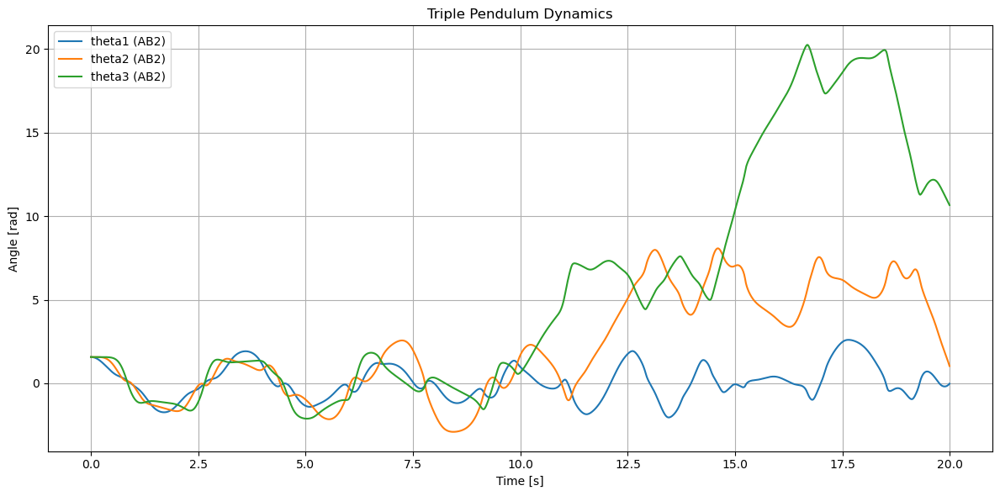

In [10]:
# Initial state: [theta1, theta2, theta3, omega1, omega2, omega3]
y0 = [np.pi/2, np.pi/2, np.pi/2, 0, 0, 0]

# Time span and step size
t_span = (0, 20)
dt = 0.01

# Parameters: gravity and pendulum specs
params = (9.81, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0)

# Use AB2
t_vals, ab2_states = simulate_triple_pendulum_ab2(y0, t_span, dt, params)

# Optionally use RK4 for comparison
_, rk4_states = simulate_triple_pendulum_rk4(y0, t_span, dt, params)

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))

plt.plot(t_vals, ab2_states[:, 0], label='theta1 (AB2)')
plt.plot(t_vals, ab2_states[:, 1], label='theta2 (AB2)')
plt.plot(t_vals, ab2_states[:, 2], label='theta3 (AB2)')

# Uncomment to compare with RK4
# plt.plot(t_vals, rk4_states[:, 0], '--', label='theta1 (RK4)')
# plt.plot(t_vals, rk4_states[:, 1], '--', label='theta2 (RK4)')
# plt.plot(t_vals, rk4_states[:, 2], '--', label='theta3 (RK4)')

plt.xlabel('Time [s]')
plt.ylabel('Angle [rad]')
plt.title('Triple Pendulum Dynamics')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


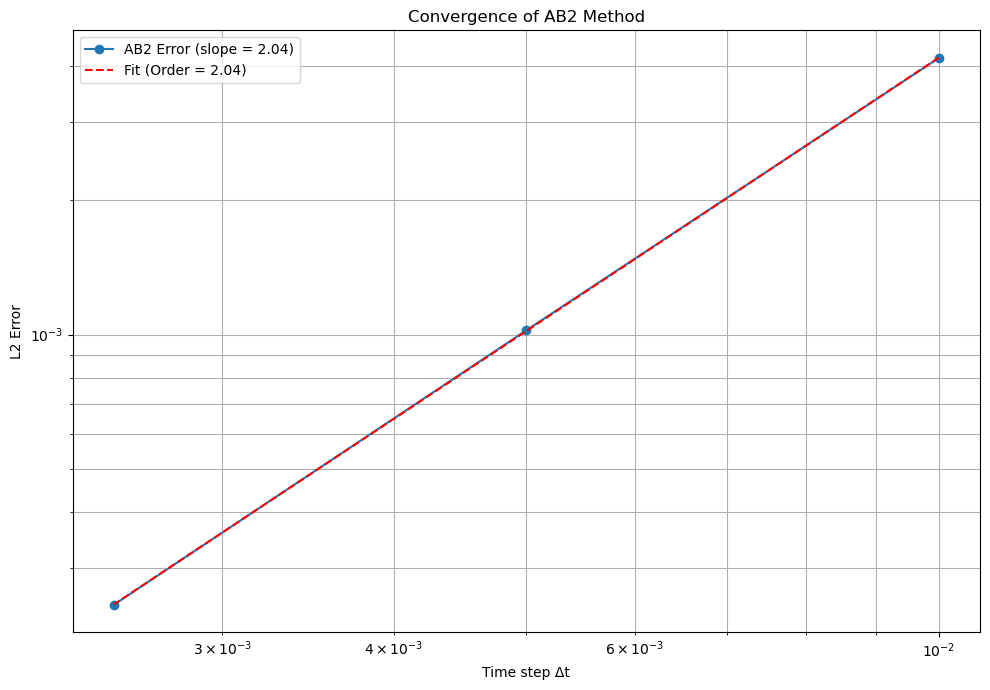

Convergence order (slope): 2.04


In [15]:

# Your reference simulation
dt_ref = 0.0005
t_ref, y_ref = simulate_triple_pendulum_ab2(y0, (0, 10), dt_ref, params)

# Coarse simulations
dts = [0.01, 0.005, 0.0025]
errors = []

for dt in dts:
    t_coarse, y_coarse = simulate_triple_pendulum_ab2(y0, (0, 2), dt, params)
    interp_func = interp1d(t_ref, y_ref[:, 0], kind='cubic')  # theta1 only
    y_ref_interp = interp_func(t_coarse)
    error = np.linalg.norm(y_coarse[:, 0] - y_ref_interp, ord=2) * np.sqrt(dt)
    errors.append(error)

# Convert to numpy arrays for fitting
dts = np.array(dts)
errors = np.array(errors)

# Fit a line to the log-log data
log_dts = np.log10(dts)
log_errors = np.log10(errors)
coefficients = np.polyfit(log_dts, log_errors, 1)  # Linear fit (1st order)
slope = coefficients[0]
intercept = coefficients[1]

# Generate fitted line for plotting
fit_line = 10**(intercept) * (dts)**(slope)

# Plotting
plt.figure(figsize=(10, 7))
plt.loglog(dts, errors, 'o-', label=f"AB2 Error (slope = {slope:.2f})")
plt.loglog(dts, fit_line, 'r--', label=f"Fit (Order = {slope:.2f})")
plt.xlabel("Time step Δt")
plt.ylabel("L2 Error")
plt.title("Convergence of AB2 Method")
plt.grid(True, which="both")
plt.legend()
plt.tight_layout()
plt.show()

print(f"Convergence order (slope): {slope:.2f}")

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parameters and initial conditions
y0 = [np.pi/2, 5*np.pi/4, 3*np.pi/2, 0, 0, 0]  # Initial angles and angular velocities
params = (9.81, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0)  # (g, l1, l2, l3, m1, m2, m3)

# Simulation parameters
t_span = (0, 20)
dt = 0.01

# Run the simulation using AB2 method
t_vals, ab2_states = simulate_triple_pendulum_ab2(y0, t_span, dt, params)

# Extract angles from the simulation results
theta1_vals = ab2_states[:, 0]
theta2_vals = ab2_states[:, 1]
theta3_vals = ab2_states[:, 2]

# Convert angles to Cartesian coordinates
l1, l2, l3 = params[1], params[2], params[3]  # Extract lengths from params
x1_vals = l1 * np.sin(theta1_vals)
y1_vals = -l1 * np.cos(theta1_vals)
x2_vals = x1_vals + l2 * np.sin(theta2_vals)
y2_vals = y1_vals - l2 * np.cos(theta2_vals)
x3_vals = x2_vals + l3 * np.sin(theta3_vals)
y3_vals = y2_vals - l3 * np.cos(theta3_vals)

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xlim(-3.5, 3.5)
ax.set_ylim(-3.5, 3.5)
ax.set_aspect('equal')
ax.grid()

# Initialize lines for the pendulum and trace
line, = ax.plot([], [], 'o-', lw=2, markersize=8)
trace, = ax.plot([], [], 'r-', lw=1, alpha=0.5)  # Trace of the third mass
time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

def init():
    line.set_data([], [])
    trace.set_data([], [])
    time_text.set_text('')
    return line, trace, time_text

def animate(i):
    # Update pendulum line
    line.set_data(
        [0, x1_vals[i], x2_vals[i], x3_vals[i]],
        [0, y1_vals[i], y2_vals[i], y3_vals[i]]
    )
    
    # Update trace (last 200 points)
    trace_length = 200
    start_idx = max(0, i - trace_length)
    trace.set_data(x3_vals[start_idx:i], y3_vals[start_idx:i])
    
    # Update time display
    time_text.set_text(f'Time = {t_vals[i]:.2f}s')
    
    return line, trace, time_text

# Create animation
# Use every 2nd frame to make it smoother (adjust as needed)
ani = FuncAnimation(
    fig, animate, frames=range(0, len(t_vals), 2),
    init_func=init, blit=True, interval=20
)

plt.title('Triple Pendulum Animation (AB2 Method)')
plt.close()

# Display in Jupyter Notebook
HTML(ani.to_jshtml())

# To save the animation (uncomment if needed)
# ani.save('triple_pendulum_ab2.mp4', writer='ffmpeg', fps=30)

Animation size has reached 20977870 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
